# **Multiclass Image Problem 🖼️**


---

Anggota Kelompok<br>
* Alyza Rahima Pramudya  - 2502032125
* Shafa Amira Qonitatin - 2502009173
* Faishal Kamil  - 2502001063


# **Import Libraries 📚**

In [ ]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.optimizers import Adam
from keras.models import Sequential
from keras.utils import to_categorical
from keras.applications import MobileNet
from tensorflow.keras.models import Model
from keras.applications import DenseNet121
from google.colab.patches import cv2_imshow
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.applications import VGG16
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import RandomOverSampler
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# **Mount Google Drive 🗃️**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Set Seed 🌱**

In [ ]:
SEED = 42
os.environ['PYTHONHASHSEED']=str(SEED)
os.environ['TF_CUDNN_DETERMINISTIC'] = '1'
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

# **1. Exploratory Data Analysis (EDA)🚵🏻**

In [ ]:
train_df = pd.read_csv("/content/drive/MyDrive/DeepLearningProject/PROJECT/train.csv")
test_df = pd.read_csv("/content/drive/MyDrive/DeepLearningProject/PROJECT/test.csv")

In [ ]:
display(train_df)

,class,image_path,name,xmax,xmin,ymax,ymin
0,3.0,4a48c42c9579ec0399e6c5a3e825e765.jpg,GARBAGE,797.0,701.0,262.0,211.0
1,3.0,4a48c42c9579ec0399e6c5a3e825e765.jpg,GARBAGE,932.0,786.0,329.0,238.0
2,3.0,4a48c42c9579ec0399e6c5a3e825e765.jpg,GARBAGE,736.0,657.0,275.0,229.0
3,7.0,ea906a663da6321bcef78be4b7d1afff.jpg,BAD_BILLBOARD,986.0,786.0,136.0,0.0
4,8.0,1c7d48005a12d1b19261b8e71df7cafe.jpg,SAND_ON_ROAD,667.0,549.0,228.0,179.0
...,...,...,...,...,...,...,...
19945,4.0,081e7bb3832ec5bb25276db161a96274.jpg,CONSTRUCTION_ROAD,1025.0,600.0,408.0,148.0
19946,2.0,1ff38a7af7f13b1201d17c6e1829373a.jpg,POTHOLES,657.0,418.0,364.0,282.0
19947,2.0,1ff38a7af7f13b1201d17c6e1829373a.jpg,POTHOLES,507.0,338.0,436.0,283.0
19948,7.0,ac97490f13140fc1bfe613ec69301b34.jpg,BAD_BILLBOARD,956.0,713.0,110.0,25.0


In [ ]:
display(test_df)

,image_path
0,953ab1447c46ecfef67ab14629cd70c7.jpg
1,e4ddbaa7970fca225a51288ce5f7d3f9.jpg
2,5b8120d69607a077b7583334be3ba18b.jpg
3,138b1dc82005b4c33e4886260649d313.jpg
4,0f91ec1533b845b13089f8cf4e0a36f7.jpg
...,...
2087,3e7dd159466f14474a0173e9b02f512a.jpg
2088,a464d4600589ddf541bed59942c0228d.jpg
2089,0a490958aac3c79bb815a0f1f6825284.jpg
2090,15afe8bce6c71deed2d53f56b78b90a8.jpg


In [ ]:
def EDA(input):
    """
      This function shows general information, anomalies information, and objects columns information.
      So, it will helps us to understand our data before further analysis.

      Love,
      Alyza, Shafa, Faishal
    """

    print('-------------------------------------------')
    print('General Information')
    print('-------------------------------------------')
    print(input.info())
    print('\n')

    print('-------------------------------------------')
    print('Anomalies Information')
    print('-------------------------------------------')
    print('Number of missing values  : ', input.isnull().sum().sum())
    print('Number of duplicated data : ', input.duplicated().sum())
    print('\n')

    print('---------------------------')
    print('Objects Columns Information')
    print('---------------------------')
    print('Total {}'.format(len(input.select_dtypes(include=['object']).columns)))
    print('\n')


In [ ]:
print(EDA.__doc__)


      This function shows general information, anomalies information, and objects columns information.
      So, it will helps us to understand our data before further analysis. 

      Love, 
      Alyza, Shafa, Faishal
    


In [ ]:
EDA(train_df)

-------------------------------------------
General Information
-------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19950 entries, 0 to 19949
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   class       19950 non-null  float64
 1   image_path  19950 non-null  object 
 2   name        19950 non-null  object 
 3   xmax        19950 non-null  float64
 4   xmin        19950 non-null  float64
 5   ymax        19950 non-null  float64
 6   ymin        19950 non-null  float64
dtypes: float64(5), object(2)
memory usage: 1.1+ MB
None


-------------------------------------------
Anomalies Information
-------------------------------------------
Number of missing values  :  0
Number of duplicated data :  0


---------------------------
Objects Columns Information
---------------------------
Total 2




In [ ]:
EDA(test_df)

-------------------------------------------
General Information
-------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2092 entries, 0 to 2091
Data columns (total 1 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  2092 non-null   object
dtypes: object(1)
memory usage: 16.5+ KB
None


-------------------------------------------
Anomalies Information
-------------------------------------------
Number of missing values  :  0
Number of duplicated data :  0


---------------------------
Objects Columns Information
---------------------------
Total 1




In [ ]:
print('Number of images in train set: ', train_df['image_path'].count())
print('Number of images in test set: ', test_df['image_path'].count())

Number of images in train set:  19950
Number of images in test set:  2092


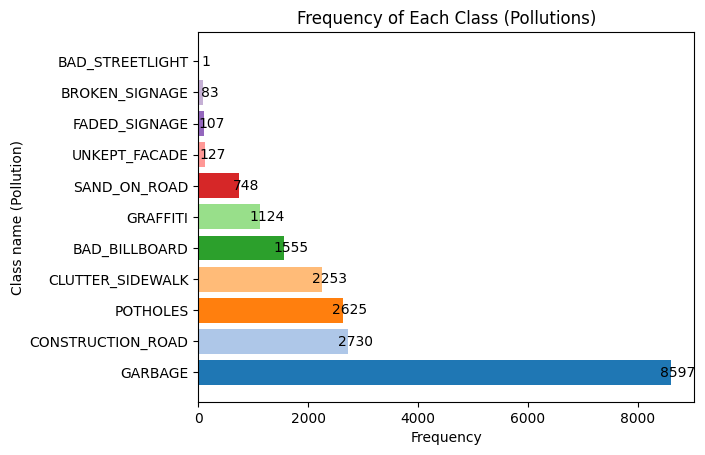

In [ ]:
class_counts = train_df['name'].value_counts()
class_names = class_counts.index
frequency = class_counts.values

col_map = plt.get_cmap("tab20")
plot = plt.barh(class_names, frequency, color=col_map.colors)

for bar in plot:
    plt.annotate(bar.get_width(),
                 xy=(bar.get_width()+2, bar.get_y()+bar.get_height()/2),
                 xytext=(5, 0),
                 textcoords='offset points',
                 ha='center',
                 va='center')

plt.title('Frequency of Each Class (Pollutions)')
plt.xlabel('Frequency')
plt.ylabel('Class name (Pollution)')
plt.show()

From the above observations, it can be seen that the distribution of the amount of data in each class is unbalanced, as seen from the amount of the GARBAGE class which reaches 8597 while the BAD_STREETLIGHT class only has 1 data.

We can also see that the dataset consists of 19,950 images, which is quite large. When we attempted to train a model using YOLOv5n in the Google Colab free edition, the runtime was terminated due to exceeding the maximum available RAM. This is a clear indication that the dataset's size is beyond our available resources, and as a result, we need to reduce its size.



BAD_BILLBOARD


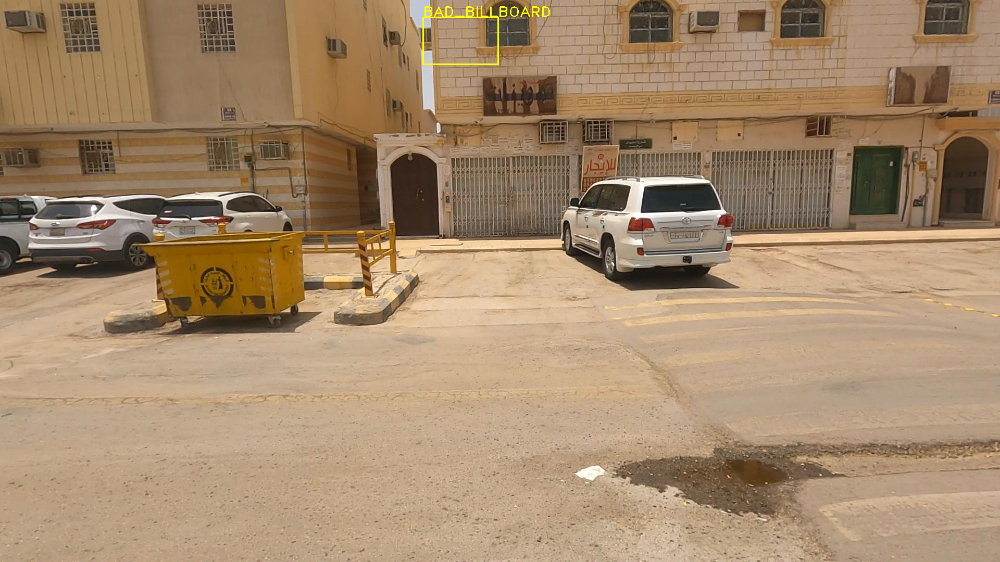



BAD_STREETLIGHT


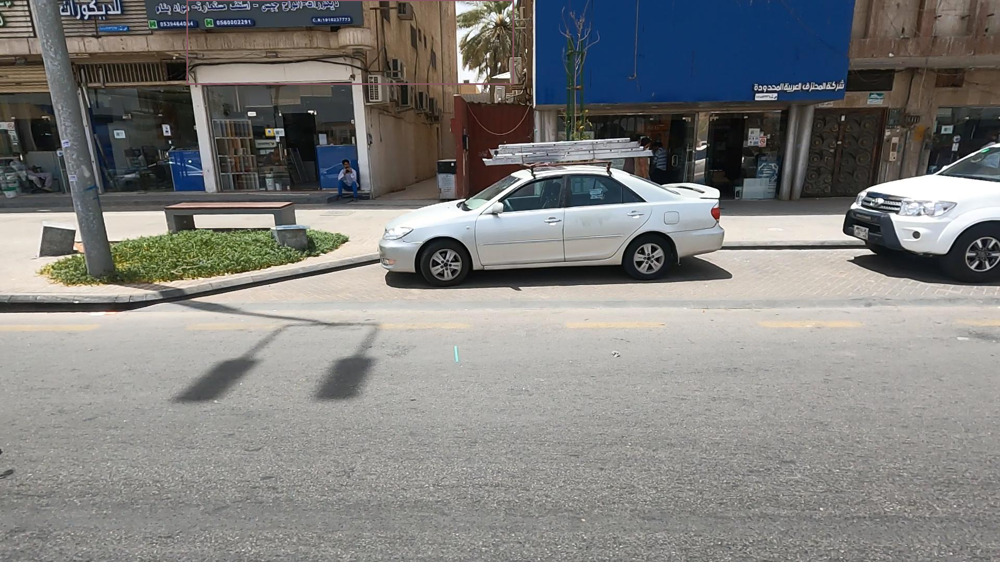



BROKEN_SIGNAGE


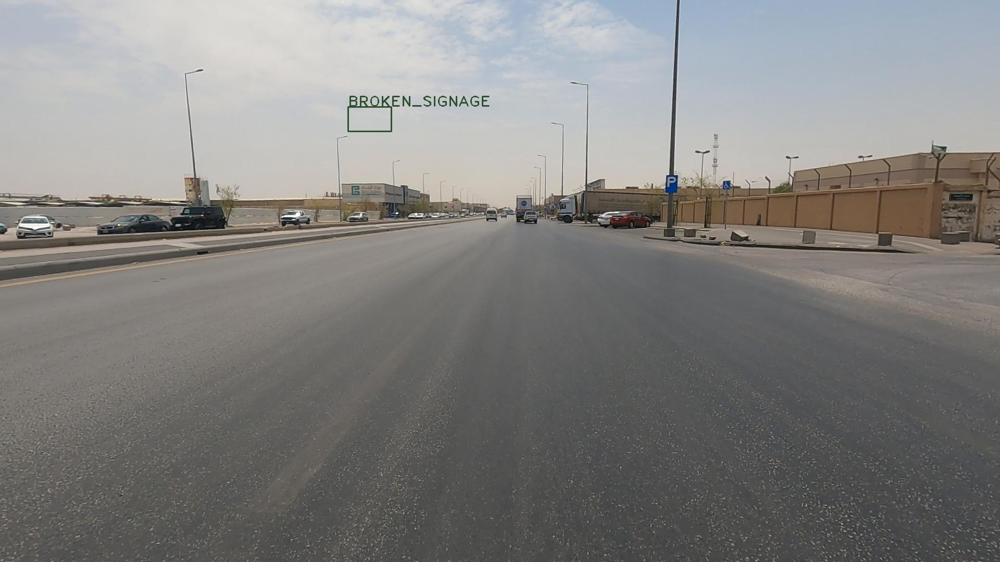



CLUTTER_SIDEWALK


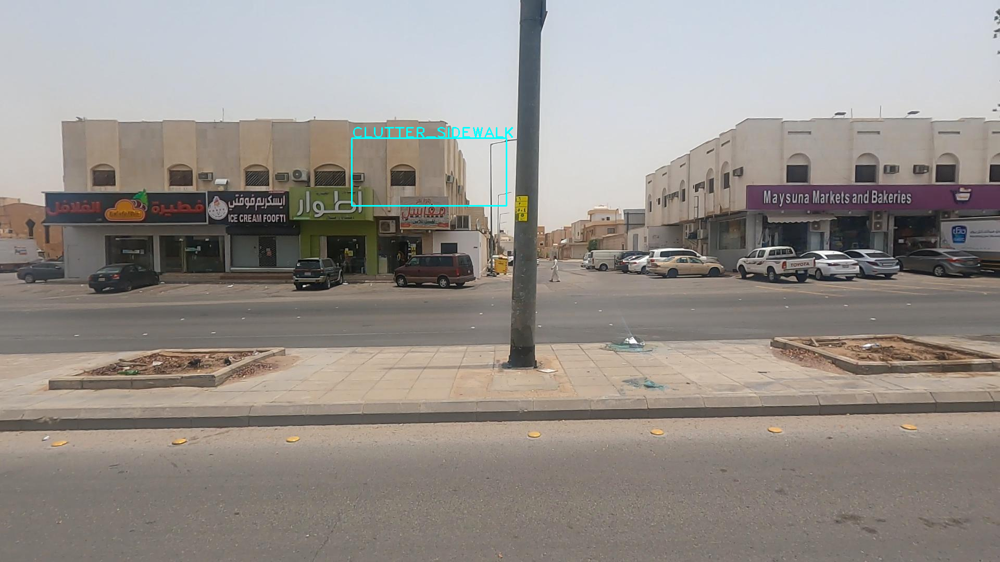



CONSTRUCTION_ROAD


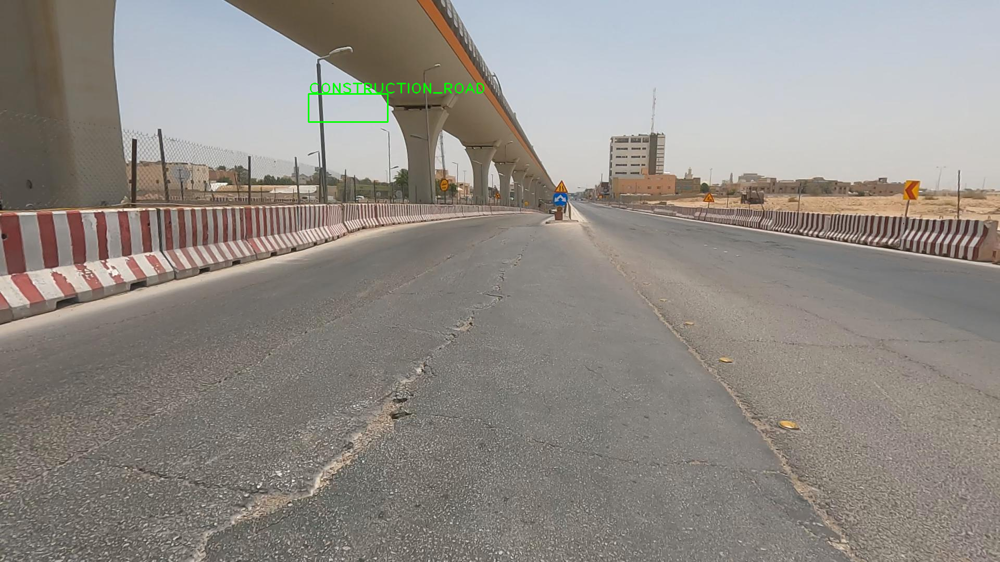



FADED_SIGNAGE


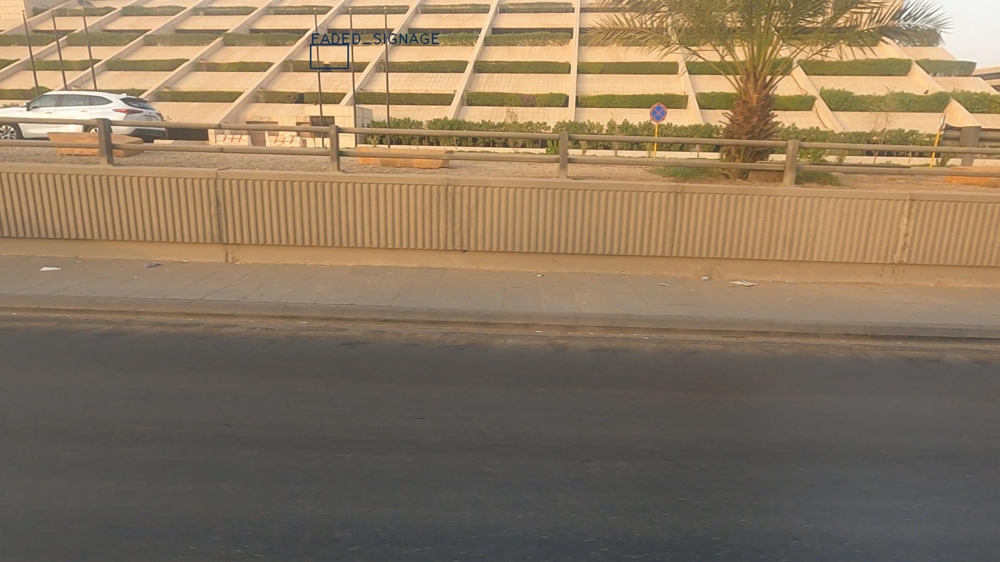



GARBAGE


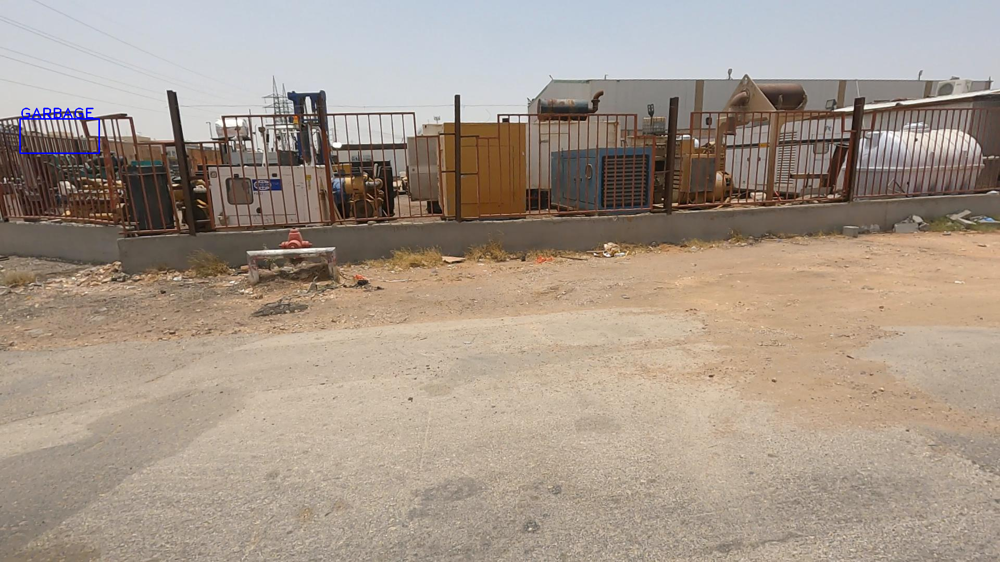



GRAFFITI


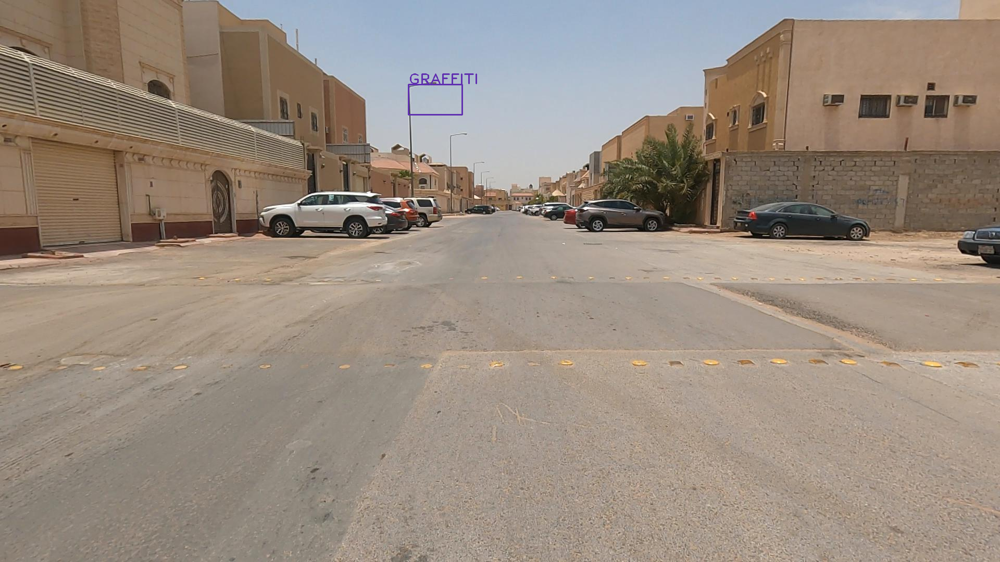



POTHOLES


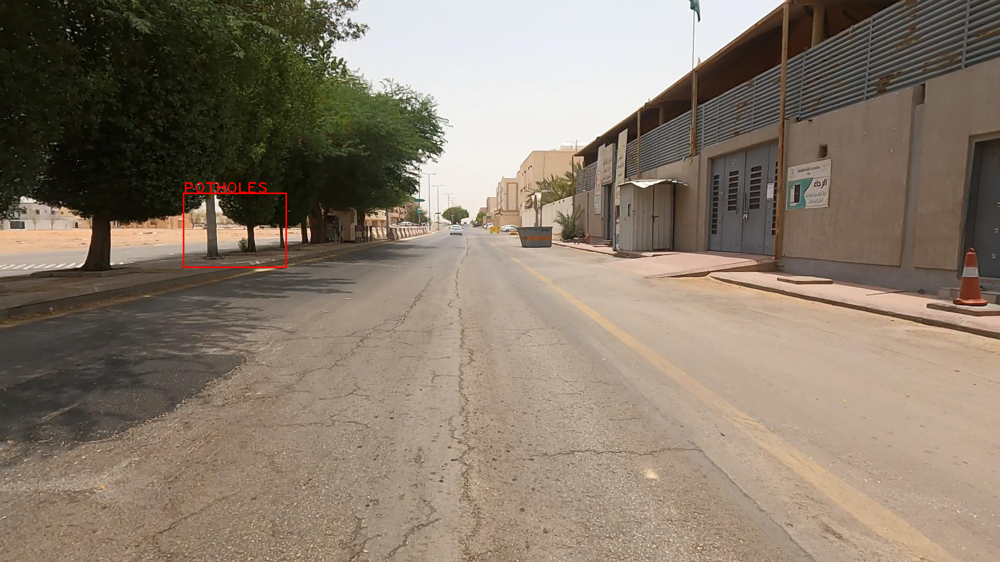



SAND_ON_ROAD


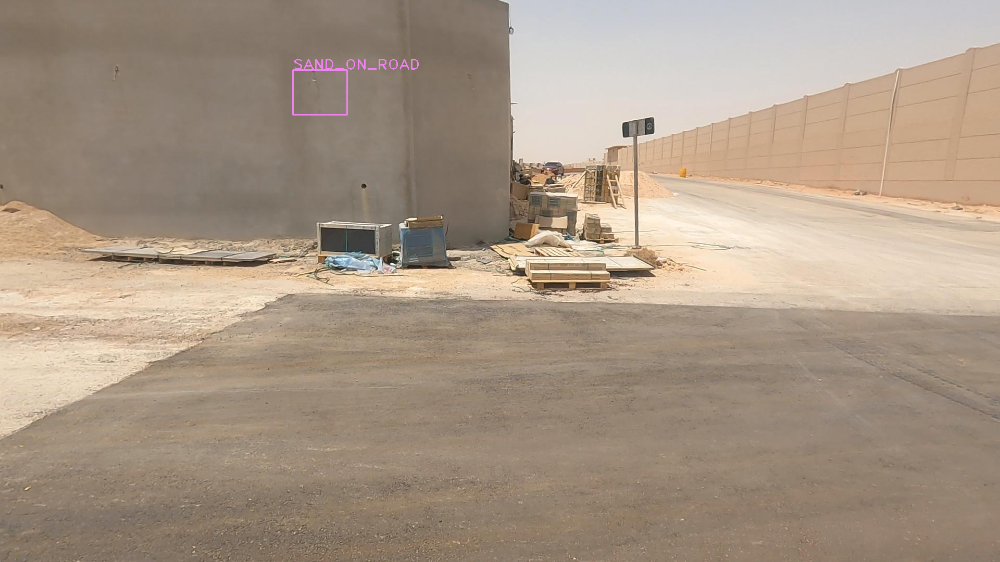



UNKEPT_FACADE


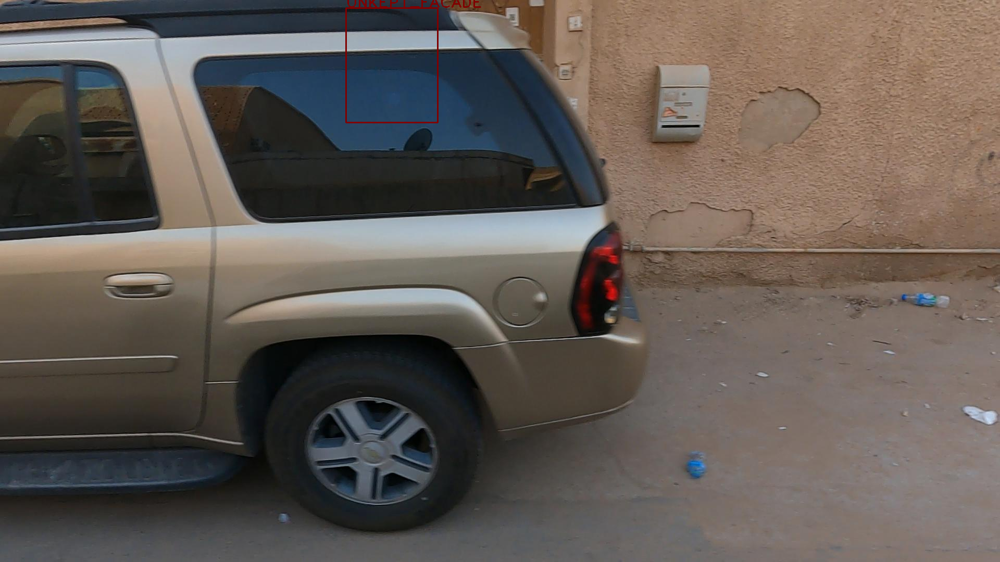

In [ ]:
# Define class color mappings
color = {
    "GARBAGE": (255, 0, 0),
    "CONSTRUCTION_ROAD": (0, 255, 0),
    "POTHOLES": (0, 0, 255),
    "CLUTTER_SIDEWALK": (255, 255, 0),
    "BAD_BILLBOARD": (0, 255, 255),
    "GRAFFITI": (176, 48, 96),
    "SAND_ON_ROAD": (238, 130, 238),
    "UNKEPT_FACADE": (0, 0, 128),
    "FADED_SIGNAGE": (92, 51, 23),
    "BROKEN_SIGNAGE": (47, 79, 47),
    "BAD_STREETLIGHT": (99, 86, 136)
}

# Group the DataFrame by class
grouped = train_df.groupby('name')

# Display one random image with bounding box from each class
for class_name, group in grouped:
    # Randomly select an image path from the current class
    random_row = group.sample(n=1)
    img_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/' + random_row['image_path'].values[0]

    # Load the image
    img = cv2.imread(img_path)

    # Retrieve the bounding box information for the selected image
    obj = random_row.iloc[0]
    obj_color = color[obj['name']]
    xmin, ymin, xmax, ymax = int(obj['xmin']), int(obj['ymin']), int(obj['xmax']), int(obj['ymax'])

    # Draw the bounding box and class label on the image
    cv2.rectangle(img, (xmin, ymin), (xmax, ymax), obj_color, 2)
    cv2.putText(img, obj['name'], (xmin, ymin), cv2.FONT_HERSHEY_PLAIN, 2, obj_color, 2)

    # Display the image
    print("\n")
    print(class_name)
    cv2_imshow(img)


From the above observation, we can see that there are some bounding boxes that not accurately indicate where the pollution (class) is located.

# **2. Data Pre-Processing 🔍**

## **2.1 Reduce the number of images**

We have decided to reduce the number of images in our dataset. One way to achieve this is through  a proportional stratified random sampling approach to maintain the distribution of samples across different classes. By considering the original number of images in each class, we can determine the proportional representation of each class in the reduced dataset. This ensures that we maintain the relative importance and diversity of each class.

Taking into account the original class distribution, we can calculate the number of images to be included in the reduced dataset. For example, if the original dataset had 8,597 images in the "Garbage" class, which accounts for approximately 43% of the total dataset, we would aim to have 2,150 images in the reduced dataset, which is 43% of the target number of images (5,000).

For more detail explanation about the distribution of the data, you can read it through our reports "DeepLearningProject.pdf"

In [ ]:
reduced_samples = {
    "GARBAGE": 2150,
    "CONSTRUCTION_ROAD": 680,
    "POTHOLES": 655,
    "CLUTTER_SIDEWALK": 560,
    "BAD_BILLBOARD": 385,
    "GRAFFITI": 280,
    "SAND_ON_ROAD": 185,
    "UNKEPT_FACADE": 30,
    "FADED_SIGNAGE": 25,
    "BROKEN_SIGNAGE": 20
}

trainReduced_df = pd.DataFrame(columns=train_df.columns)

for class_name, num_samples in reduced_samples.items():
    class_rows = train_df[train_df['name'] == class_name]
    if len(class_rows) <= num_samples:
        sampled_rows = class_rows  # Take all available samples
    else:
        sampled_rows = class_rows.sample(n=num_samples, random_state=42)
    trainReduced_df = trainReduced_df.append(sampled_rows)

reduced_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/reduced/trainReduced.csv'
trainReduced_df.to_csv(reduced_path, index=False)

<ipython-input-7-82ec1e29d0b8>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trainReduced_df = trainReduced_df.append(sampled_rows)
<ipython-input-7-82ec1e29d0b8>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trainReduced_df = trainReduced_df.append(sampled_rows)
<ipython-input-7-82ec1e29d0b8>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trainReduced_df = trainReduced_df.append(sampled_rows)
<ipython-input-7-82ec1e29d0b8>:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trainReduced_df = trainReduced_df.append(sampled_rows)
<ipython-input-7-82ec1e29d0b8>:22: FutureWarning: The frame.append method is deprecated and will be 

In [ ]:
trainReduced_df = pd.read_csv("/content/drive/MyDrive/DeepLearningProject/PROJECT/reduced/trainReduced.csv")

In [ ]:
trainReduced_df.head()

,class,image_path,name,xmax,xmin,ymax,ymin
0,3.0,597f2fe91daa51d5e56938276356a746.jpg,GARBAGE,357.0,296.0,323.0,273.0
1,3.0,df9cb70dbe0ae07e87bbe14e7e618f21.jpg,GARBAGE,640.0,445.0,407.0,292.0
2,3.0,5c0a3fa0622d5acad1f14283358daeb4.jpg,GARBAGE,528.0,446.0,194.0,140.0
3,3.0,bf7bdc87075e8a8cca8b152b6d21b50d.jpg,GARBAGE,886.0,761.0,287.0,163.0
4,3.0,fe26a0704daab304d4da7509511e1845.jpg,GARBAGE,589.0,326.0,369.0,316.0


In [ ]:
trainReduced_df['image_path'].count()

4970

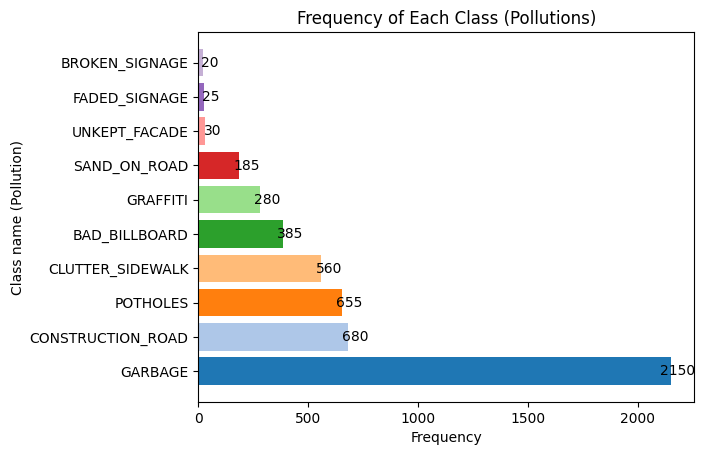

In [ ]:
class_counts = trainReduced_df['name'].value_counts()
class_names = class_counts.index
frequency = class_counts.values

col_map = plt.get_cmap("tab20")
plot = plt.barh(class_names, frequency, color=col_map.colors)

for bar in plot:
    plt.annotate(bar.get_width(),
                 xy=(bar.get_width()+2, bar.get_y()+bar.get_height()/2),
                 xytext=(5, 0),
                 textcoords='offset points',
                 ha='center',
                 va='center')

plt.title('Frequency of Each Class (Pollutions)')
plt.xlabel('Frequency')
plt.ylabel('Class name (Pollution)')
plt.show()

## **2.2 Check image size**

In [ ]:
IMG_PATH = "/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/597f2fe91daa51d5e56938276356a746.jpg"

img = cv2.imread(IMG_PATH)
img_obj = trainReduced_df[trainReduced_df['image_path'] == IMG_PATH.split('/')[-1]]
img.shape

(1080, 1920, 3)

In [ ]:
IMG_PATH = "/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/953ab1447c46ecfef67ab14629cd70c7.jpg"

img = cv2.imread(IMG_PATH)
img_obj = test_df[test_df['image_path'] == IMG_PATH.split('/')[-1]]
img.shape

(1080, 1920, 3)

Based on the above output, it is known that the images are 1080 pixels high, 1920 pixels wide, and use RGB color mode with three channels and we assume that the size of all images is the same as the sample.

## **2.3 Preparation Object Detection**

### 2.3.1 resize images

We want to train a model on these images, but larger images take a long time to train. So, we resize the images to 540 pixels high and 960 pixels wide. This makes them smaller and easier to train on.

In [ ]:
from tqdm import tqdm
train_df = trainReduced_df

output_folder = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resizedYOLO/trainVal'
Length = len(train_df)

for i in tqdm(range(Length)):
    input_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/' + train_df['image_path'][i]
    img = cv2.imread(input_path)
    img = cv2.resize(img, (960, 540))

    output_path = os.path.join(output_folder, train_df['image_path'][i])
    cv2.imwrite(output_path, img)

100%|██████████| 4970/4970 [1:08:08<00:00,  1.22it/s]


In [ ]:
from tqdm import tqdm
test_df1 = test_df

output_folder = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resizedYOLO/test'
Length = len(test_df1)

for i in tqdm(range(Length)):
    input_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/' + test_df1['image_path'][i]
    img = cv2.imread(input_path)
    img = cv2.resize(img, (960, 540))

    output_path = os.path.join(output_folder, test_df1['image_path'][i])
    cv2.imwrite(output_path, img)

100%|██████████| 2092/2092 [28:00<00:00,  1.24it/s]


### 2.3.2 Fixing the bounding box

In [ ]:
train_df['xmin'] = np.where(train_df['xmin'] < 0, 0, train_df['xmin'])
train_df['xmax'] = np.where(train_df['xmax'] < 0, 0, train_df['xmax'])
train_df['ymin'] = np.where(train_df['ymin'] < 0, 0, train_df['ymin'])
train_df['ymax'] = np.where(train_df['ymax'] < 0, 0, train_df['ymax'])

In [ ]:
train_df['xmin'] = np.where(train_df['xmin'] > 960 , 960, train_df['xmin'])
train_df['xmax'] = np.where(train_df['xmax'] > 960, 960, train_df['xmax'])
train_df['ymin'] = np.where(train_df['ymin'] > 540, 540, train_df['ymin'])
train_df['ymax'] = np.where(train_df['ymax'] > 540, 540, train_df['ymax'])

### 2.3.3 Create x_center & y_center

In [ ]:
train_df['x_center'] = (train_df['xmax'] + train_df['xmin']) / 2
train_df['y_center'] = (train_df['ymax'] + train_df['ymin']) / 2

### 2.3.4 Create Height and width of the bounding box

In [ ]:
train_df['width'] = train_df['xmax'] - train_df['xmin']
train_df['height'] = train_df['ymax'] - train_df['ymin']

### 2.3.5 Normalize xcenter, ycenter, width, and height

In [ ]:
train_df['x_center'] = train_df.apply(lambda row: ((row['xmax'] + row['xmin']) / (2 * 960)), axis=1)
train_df['y_center'] = train_df.apply(lambda row: ((row['ymax'] + row['ymin']) / (2 * 540)), axis=1)
train_df['width'] = train_df.apply(lambda row: ((row['xmax'] - row['xmin']) / 960), axis=1)
train_df['height'] = train_df.apply(lambda row: ((row['ymax'] - row['ymin']) / 540), axis=1)

In [ ]:
train_df.head()

,class,image_path,name,xmax,xmin,ymax,ymin,x_center,y_center,width,height
0,3.0,597f2fe91daa51d5e56938276356a746.jpg,GARBAGE,357.0,296.0,323.0,273.0,0.340104,0.551852,0.063542,0.092593
1,3.0,df9cb70dbe0ae07e87bbe14e7e618f21.jpg,GARBAGE,640.0,445.0,407.0,292.0,0.565104,0.647222,0.203125,0.212963
2,3.0,5c0a3fa0622d5acad1f14283358daeb4.jpg,GARBAGE,528.0,446.0,194.0,140.0,0.507292,0.309259,0.085417,0.100000
3,3.0,bf7bdc87075e8a8cca8b152b6d21b50d.jpg,GARBAGE,886.0,761.0,287.0,163.0,0.857812,0.416667,0.130208,0.229630
4,3.0,fe26a0704daab304d4da7509511e1845.jpg,GARBAGE,589.0,326.0,369.0,316.0,0.476562,0.634259,0.273958,0.098148


### 2.3.6 Check Sample



BAD_BILLBOARD


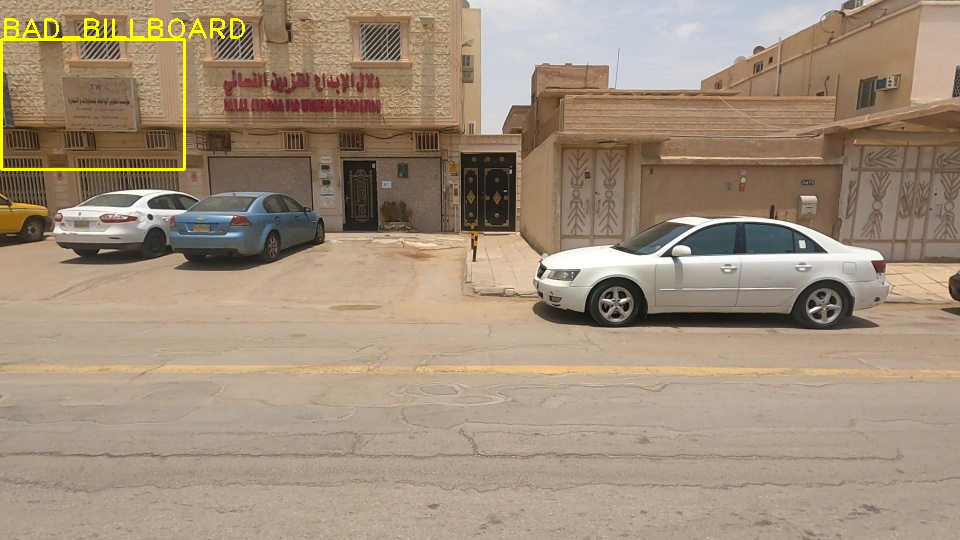



BROKEN_SIGNAGE


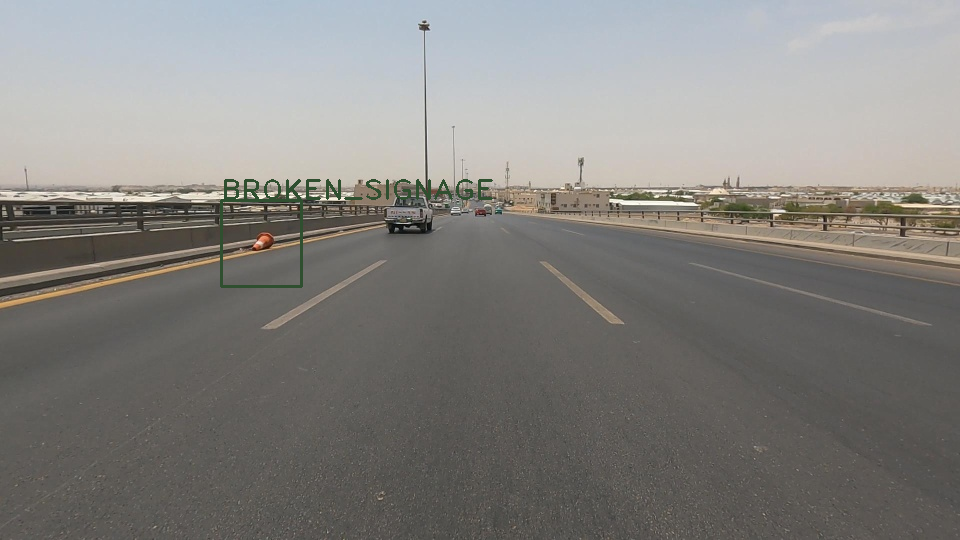



CLUTTER_SIDEWALK


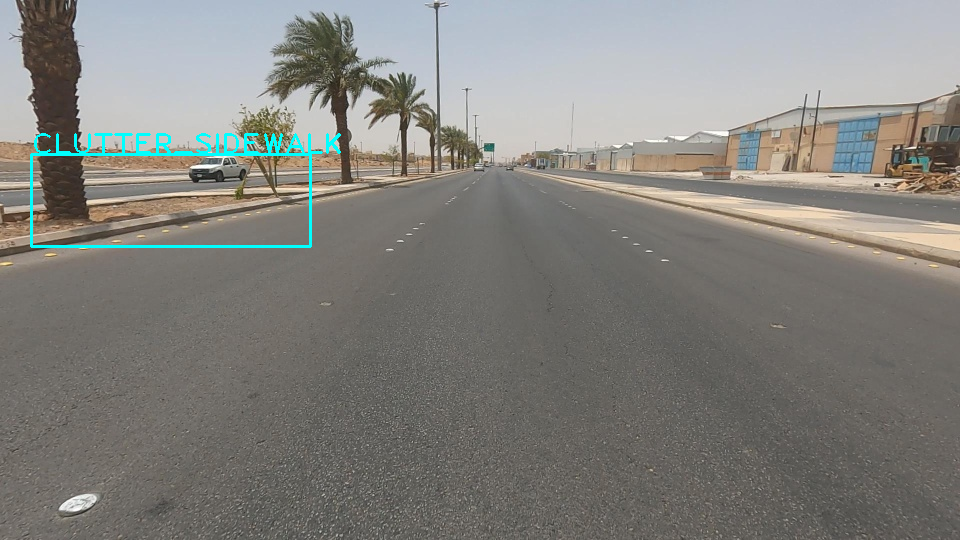



CONSTRUCTION_ROAD


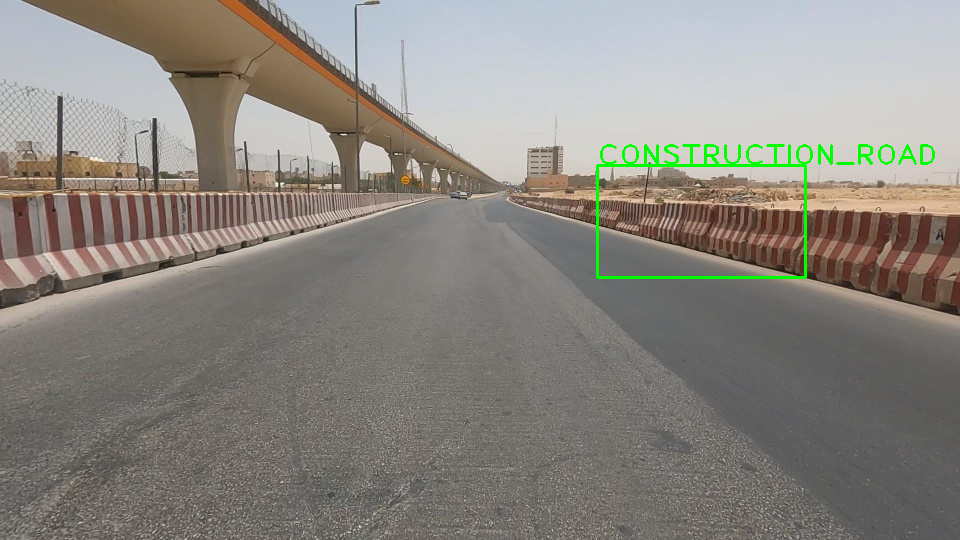



FADED_SIGNAGE


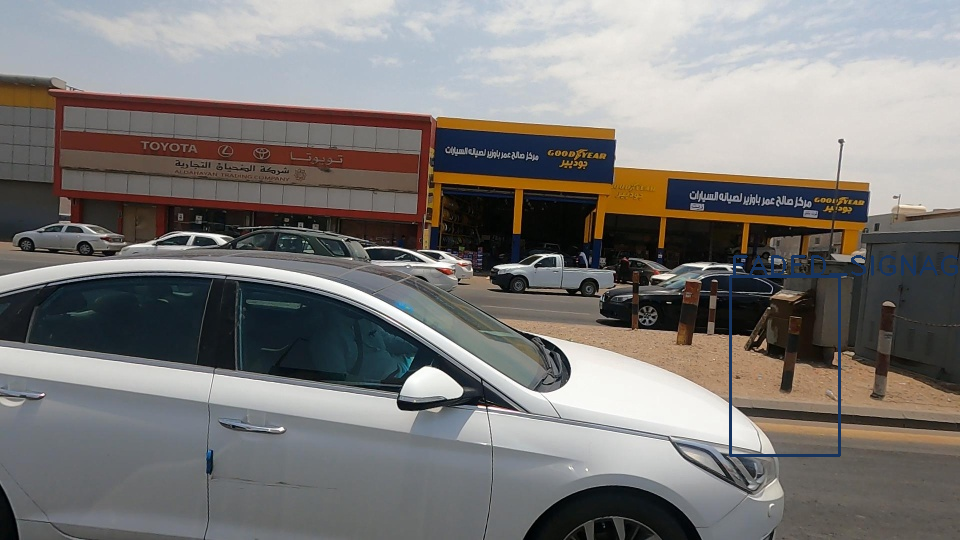



GARBAGE


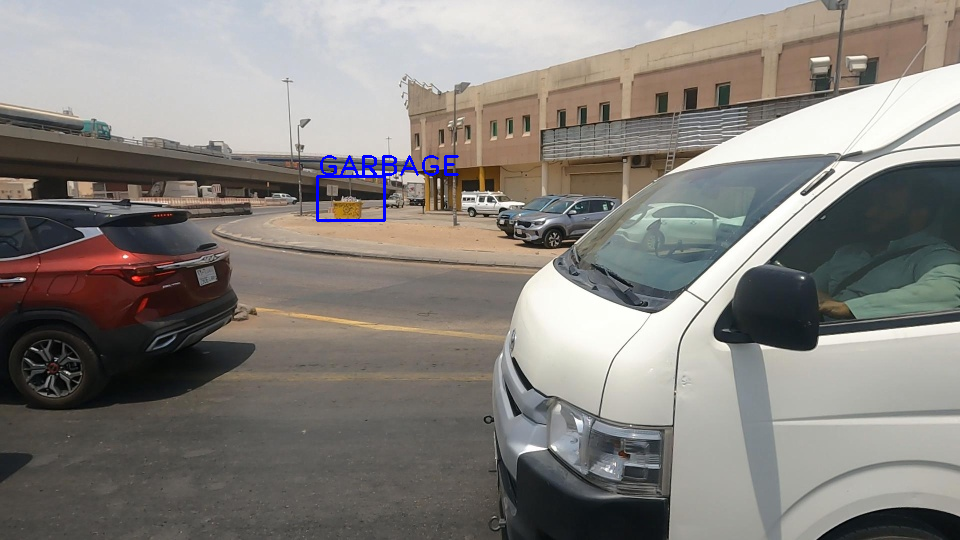



GRAFFITI


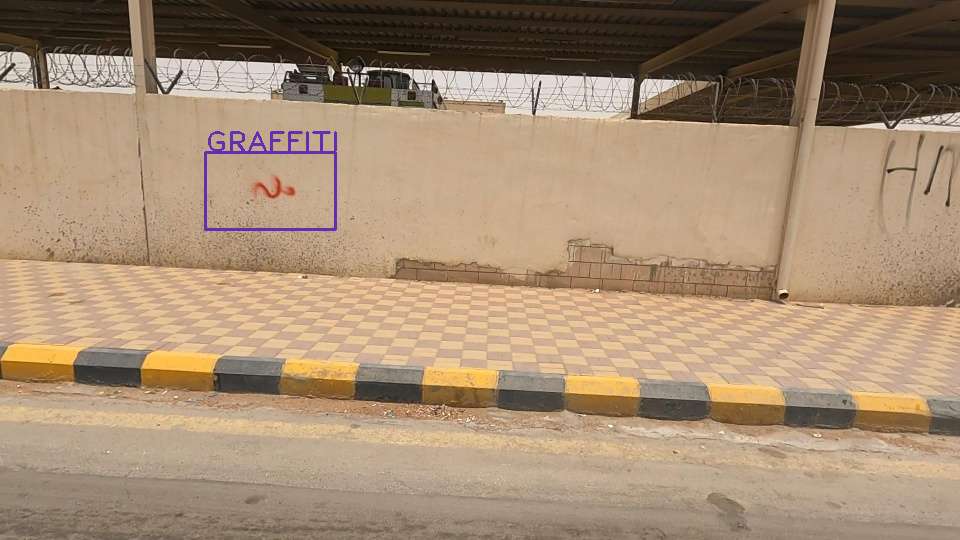



POTHOLES


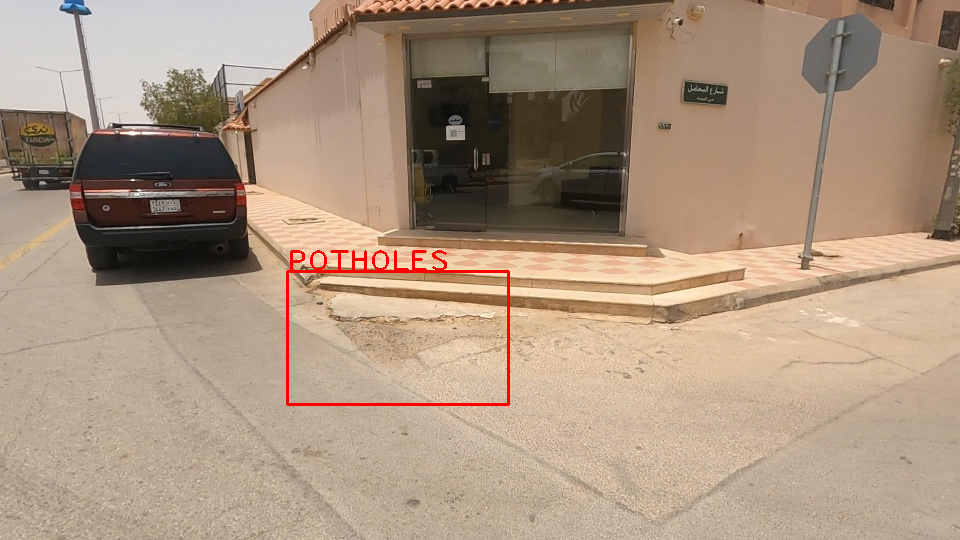



SAND_ON_ROAD


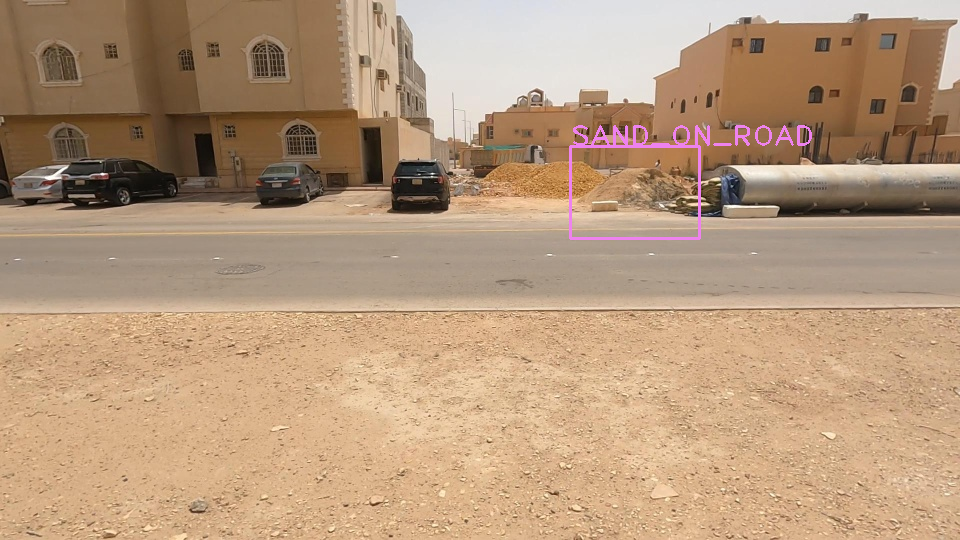



UNKEPT_FACADE


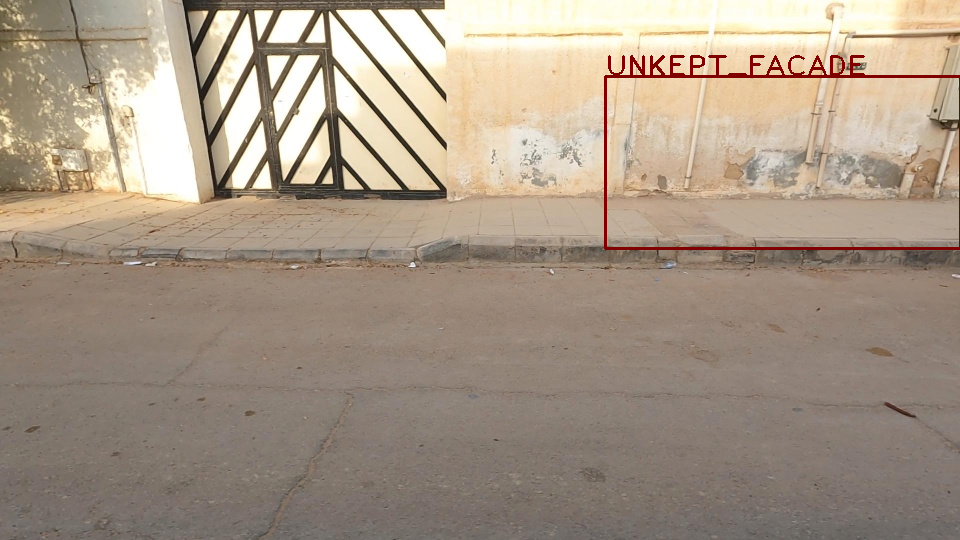

In [ ]:
# Group the DataFrame by class
grouped = train_df.groupby('name')

# Display one random image with bounding box from each class
for class_name, group in grouped:
    # Randomly select an image path from the current class
    random_row = group.sample(n=1)
    img_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resizedYOLO/trainVal/' + random_row['image_path'].values[0]

    # Load the image
    img = cv2.imread(img_path)

    # Retrieve the bounding box information for the selected image
    obj = random_row.iloc[0]
    obj_color = color[obj['name']]
    xmin, ymin, xmax, ymax = int(obj['xmin']), int(obj['ymin']), int(obj['xmax']), int(obj['ymax'])

    # Draw the bounding box and class label on the image
    cv2.rectangle(img, (xmin, ymin), (xmax, ymax), obj_color, 2)
    cv2.putText(img, obj['name'], (xmin, ymin), cv2.FONT_HERSHEY_PLAIN, 2, obj_color, 2)

    # Display the image
    print("\n")
    print(class_name)
    cv2_imshow(img)

### 2.3.7 Split Train and Valid Set

In [ ]:
print("80% from 4970:", int(4970*0.8))

80% from 4970: 3976


In [ ]:
train = trainReduced_df[0:3976]
valid = trainReduced_df[3976:]

In [ ]:
print ("Train shape:", train.shape)
print ("Valid shape:", valid.shape)

Train shape: (3976, 7)
Valid shape: (994, 7)


In [ ]:
train['image_path'] = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal' + train['image_path']
valid['image_path'] = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal' + valid['image_path']
test_df['image_path'] = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/test' + test_df['image_path']

<ipython-input-41-82efbd426080>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['image_path'] = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal' + train['image_path']
<ipython-input-41-82efbd426080>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid['image_path'] = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal' + valid['image_path']


In [ ]:
train.head()

,class,image_path,name,xmax,xmin,ymax,ymin
0,3.0,/content/drive/MyDrive/DeepLearningProject/PRO...,GARBAGE,357.0,296.0,323.0,273.0
1,3.0,/content/drive/MyDrive/DeepLearningProject/PRO...,GARBAGE,640.0,445.0,407.0,292.0
2,3.0,/content/drive/MyDrive/DeepLearningProject/PRO...,GARBAGE,528.0,446.0,194.0,140.0
3,3.0,/content/drive/MyDrive/DeepLearningProject/PRO...,GARBAGE,886.0,761.0,287.0,163.0
4,3.0,/content/drive/MyDrive/DeepLearningProject/PRO...,GARBAGE,589.0,326.0,369.0,316.0


In [ ]:
valid.head()

,class,image_path,name,xmax,xmin,ymax,ymin
3976,9.0,/content/drive/MyDrive/DeepLearningProject/PRO...,CLUTTER_SIDEWALK,353.0,30.0,283.0,206.0
3977,9.0,/content/drive/MyDrive/DeepLearningProject/PRO...,CLUTTER_SIDEWALK,223.0,78.0,227.0,156.0
3978,9.0,/content/drive/MyDrive/DeepLearningProject/PRO...,CLUTTER_SIDEWALK,874.0,306.0,402.0,288.0
3979,9.0,/content/drive/MyDrive/DeepLearningProject/PRO...,CLUTTER_SIDEWALK,661.0,288.0,295.0,174.0
3980,9.0,/content/drive/MyDrive/DeepLearningProject/PRO...,CLUTTER_SIDEWALK,575.0,40.0,396.0,279.0


In [ ]:
test_df.head()

,image_path
0,/content/drive/MyDrive/DeepLearningProject/PRO...
1,/content/drive/MyDrive/DeepLearningProject/PRO...
2,/content/drive/MyDrive/DeepLearningProject/PRO...
3,/content/drive/MyDrive/DeepLearningProject/PRO...
4,/content/drive/MyDrive/DeepLearningProject/PRO...


In [ ]:
import shutil

# Path to the folder containing the images
path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/'
image_folder_path = path + 'resizedYOLO/trainVal'

# Create new directories for the new dataset
new_model_dir = path + 'model'
new_train_dir = new_model_dir + '/train'
new_valid_dir = new_model_dir + '/valid'
new_test_dir = new_model_dir + '/test'
new_img_train_dir = new_train_dir + '/images'
new_img_valid_dir = new_valid_dir + '/images'
new_img_test_dir = new_test_dir + '/images'
new_label_train_dir = new_train_dir + '/labels'
new_label_valid_dir = new_valid_dir + '/labels'

os.makedirs(new_model_dir, exist_ok=True)
os.makedirs(new_train_dir, exist_ok=True)
os.makedirs(new_valid_dir, exist_ok=True)
os.makedirs(new_test_dir, exist_ok=True)
os.makedirs(new_img_train_dir, exist_ok=True)
os.makedirs(new_img_valid_dir, exist_ok=True)
os.makedirs(new_img_test_dir, exist_ok=True)
os.makedirs(new_label_train_dir, exist_ok=True)
os.makedirs(new_label_valid_dir, exist_ok=True)

In [ ]:
# Copy images and create label files for training set
for _, row in train.iterrows():
    image_path = row['image_path']
    image_name = os.path.basename(image_path)
    new_image_path = os.path.join(new_img_train_dir, image_name)
    shutil.copyfile(os.path.join(image_folder_path, image_path), new_image_path)

    # Create label file
    label_file_path = os.path.join(new_label_train_dir, os.path.splitext(image_name)[0] + '.txt')
    with open(label_file_path, 'w') as label_file:
        label_file.write(f"{row['class']} {row['x_center']} {row['y_center']} {row['width']} {row['height']}")

In [ ]:
# Copy images and create label files for validation set
for _, row in valid.iterrows():
    image_path = row['image_path']
    image_name = os.path.basename(image_path)
    new_image_path = os.path.join(new_img_valid_dir, image_name)
    shutil.copyfile(os.path.join(image_folder_path, image_path), new_image_path)

    # Create label file
    label_file_path = os.path.join(new_label_valid_dir, os.path.splitext(image_name)[0] + '.txt')
    with open(label_file_path, 'w') as label_file:
        label_file.write(f"{row['class']} {row['x_center']} {row['y_center']} {row['width']} {row['height']}")

In [ ]:
# Copy images and create label files for test set
for _, row in test_df.iterrows():
    image_path = row['image_path']
    image_name = os.path.basename(image_path)
    new_image_path = os.path.join(new_img_test_dir, image_name)
    shutil.copyfile(os.path.join(image_folder_path, image_path), new_image_path)

## **2.4 Preparation Image Classification**

### 2.4.1 Resize image sizes

We want to train a model on these images, but larger images take a long time to train. So, we resize the images to 640 pixels high and 640 pixels wide. This makes them smaller and easier to train on.

In [ ]:
output_folder = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal'
Length = len(trainReduced_df)

for i in tqdm(range(Length)):
    input_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/' + trainReduced_df['image_path'][i]
    img = cv2.imread(input_path)
    img = cv2.resize(img, (640, 640))

    output_path = os.path.join(output_folder, trainReduced_df['image_path'][i])
    cv2.imwrite(output_path, img)

100%|██████████| 4970/4970 [25:22<00:00,  3.26it/s]


In [ ]:
output_folder = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/test'
Length = len(test_df)

for i in tqdm(range(Length)):
    input_path = '/content/drive/MyDrive/DeepLearningProject/PROJECT/images/images/' + test_df['image_path'][i]
    img = cv2.imread(input_path)
    img = cv2.resize(img, (640, 640))

    output_path = os.path.join(output_folder, test_df['image_path'][i])
    cv2.imwrite(output_path, img)

100%|██████████| 2092/2092 [02:02<00:00, 17.12it/s]


In [ ]:
IMG_PATH = "/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal/597f2fe91daa51d5e56938276356a746.jpg"

img = cv2.imread(IMG_PATH)
img_obj = trainReduced_df[trainReduced_df['image_path'] == IMG_PATH.split('/')[-1]]
img.shape

(640, 640, 3)

In [ ]:
IMG_PATH = "/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/test/953ab1447c46ecfef67ab14629cd70c7.jpg"

img = cv2.imread(IMG_PATH)
img_obj = test_df[test_df['image_path'] == IMG_PATH.split('/')[-1]]
img.shape

(640, 640, 3)

### 2.4.2 Create Train, Valid, Test Generator

In [ ]:
# Define batch size and image size
batch_size = 16
image_size = (640, 640)

# Define the image folder path
image_folder = '/content/drive/MyDrive/DeepLearningProject/PROJECT/resized/trainVal'

# Split the data into train and validation sets
train_df, temp_df = train_test_split(trainReduced_df, test_size=0.2, random_state=42)
test_df, val_df = train_test_split(temp_df, test_size=0.5, random_state=42)

# Create a list of image paths and corresponding labels
train_image_paths = [os.path.join(image_folder, row['image_path']) for _, row in train_df.iterrows()]
train_labels = train_df['name']

# Create a list of image paths and corresponding labels for validation set
valid_image_paths = [os.path.join(image_folder, row['image_path']) for _, row in val_df.iterrows()]
valid_labels = val_df['name']

test_image_paths = [os.path.join(image_folder, row['image_path']) for _, row in test_df.iterrows()]
test_labels = test_df['name']

train_datagen = ImageDataGenerator(rescale=1.0/255)
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    directory=image_folder,
    x_col='image_path',
    y_col='name',
    class_mode='categorical',
    target_size=image_size,
    batch_size=batch_size
)

valid_datagen = ImageDataGenerator(rescale=1.0/255)
valid_generator = valid_datagen.flow_from_dataframe(
    dataframe=val_df,
    directory=image_folder,
    x_col='image_path',
    y_col='name',
    class_mode='categorical',
    target_size=image_size,
    batch_size=batch_size
)

test_datagen = ImageDataGenerator(rescale=1.0/255)
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    directory=image_folder,
    x_col='image_path',
    y_col='name',
    class_mode='categorical',
    target_size=image_size,
    batch_size=batch_size
)

Found 3976 validated image filenames belonging to 10 classes.
Found 497 validated image filenames belonging to 10 classes.
Found 497 validated image filenames belonging to 9 classes.


# **3. Modelling, Tuning, and Evaluation 👷🏻‍♂️🚧🏗️**

## **3.1 YOLO**

In [ ]:
!git clone https://github.com/ultralytics/yolov5 '/content/drive/MyDrive/DeepLearningProject/PROJECT/yolov5'

Cloning into '/content/drive/MyDrive/DeepLearningWWW/yolov5'...
remote: Enumerating objects: 15978, done.
remote: Counting objects: 100% (147/147), done.
remote: Compressing objects: 100% (77/77), done.
remote: Total 15978 (delta 89), reused 111 (delta 70), pack-reused 15831
Receiving objects: 100% (15978/15978), 14.60 MiB | 11.35 MiB/s, done.
Resolving deltas: 100% (10962/10962), done.
Updating files: 100% (142/142), done.


In [ ]:
%cd /content/drive/MyDrive/DeepLearningProject/PROJECT/yolov5

/content/drive/MyDrive/DeepLearningWWW/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 599.6/599.6 kB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.5 MB/s eta 0:00:00


In [ ]:
!python train.py --batch 8 --epochs 5 --data ../data.yaml --weights yolov5n.pt --img 960

train: weights=yolov5n.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=8, imgsz=960, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-178-ga199480 Python-3.10.12 torch-2.0.1+cu118 CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.

## **3.2 VGG16**



### 3.2.1 Epoch 10

In [ ]:
num_classes = 10

# Load the pre-trained VGG16 model (excluding the top layer)
baseModel = VGG16(weights='imagenet', include_top=False, input_shape=(640, 640, 3))

# Freeze the pre-trained layers
for layer in baseModel.layers:
    layer.trainable = False

# Add custom layers for classification
x = baseModel.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Create the final model
model10 = Model(inputs=baseModel.input, outputs=predictions)

58889256/58889256 [==============================] - 4s 0us/step


In [ ]:
# Compile the model
model10.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model10.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 640, 640, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 640, 640, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 640, 640, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 320, 320, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 320, 320, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 320, 320, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 160, 160, 128)     0     

In [ ]:
# Train the model10
model10.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=valid_generator,
    validation_steps=valid_generator.samples // batch_size
)

Epoch 1/10
248/248 [==============================] - 799s 3s/step - loss: 1.5999 - accuracy: 0.4621 - val_loss: 1.4876 - val_accuracy: 0.4637
Epoch 2/10
248/248 [==============================] - 76s 305ms/step - loss: 1.3841 - accuracy: 0.5146 - val_loss: 1.3677 - val_accuracy: 0.5242
Epoch 3/10
248/248 [==============================] - 76s 306ms/step - loss: 1.3203 - accuracy: 0.5366 - val_loss: 1.3148 - val_accuracy: 0.5323
Epoch 4/10
248/248 [==============================] - 76s 307ms/step - loss: 1.2690 - accuracy: 0.5515 - val_loss: 1.3408 - val_accuracy: 0.5383
Epoch 5/10
248/248 [==============================] - 76s 305ms/step - loss: 1.2412 - accuracy: 0.5563 - val_loss: 1.2642 - val_accuracy: 0.5524
Epoch 6/10
248/248 [==============================] - 76s 304ms/step - loss: 1.2046 - accuracy: 0.5725 - val_loss: 1.2015 - val_accuracy: 0.5524
Epoch 7/10
248/248 [==============================] - 76s 305ms/step - loss: 1.1751 - accuracy: 0.5929 - val_loss: 1.2062 - val_accu

In [ ]:
model10.save('trained_model10.h5')

In [ ]:
val_loss, val_accuracy = model10.evaluate(valid_generator, steps=valid_generator.samples // batch_size)
print('Valid Loss:', val_loss)
print('Valid Accuracy:', val_accuracy)

31/31 [==============================] - 9s 277ms/step - loss: 1.1773 - accuracy: 0.5887
Valid Loss: 1.1773186922073364
Valid Accuracy: 0.5887096524238586


In [ ]:
predictions = model10.predict(test_generator, steps=test_generator.samples // batch_size)
predicted_labels = np.argmax(predictions, axis=1)
true_labels = test_generator.classes

if len(true_labels) != len(predicted_labels):
    num_samples = min(len(true_labels), len(predicted_labels))
    true_labels = true_labels[:num_samples]
    predicted_labels = predicted_labels[:num_samples]
    test_generator.samples = num_samples
    test_generator.n = num_samples

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='macro')
recall = recall_score(true_labels, predicted_labels, average='macro')
f1 = f1_score(true_labels, predicted_labels, average='macro')

print('Accuracy:', accuracy)
print('Precision:', precision)
print('Recall:', recall)
print('F1-score:', f1)

31/31 [==============================] - 63s 2s/step
Accuracy: 0.2439516129032258
Precision: 0.09062774791236122
Recall: 0.09658616291434992
F1-score: 0.09230830352897194


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import classification_report
y_pred = model10.predict_generator(test_generator)
y_pred = np.argmax(y_pred, axis=1)
y_true = test_generator.classes

if len(y_true) != len(y_pred):
    num_samples = min(len(y_true), len(y_pred))
    y_true = y_true[:num_samples]
    y_pred = y_pred[:num_samples]

report = classification_report(y_true, y_pred)
print(report)

<ipython-input-14-d1879fd270f4>:2: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = model10.predict_generator(test_generator)


              precision    recall  f1-score   support

           0       0.06      0.10      0.08        41
           1       0.00      0.00      0.00         1
           2       0.17      0.14      0.15        59
           3       0.12      0.11      0.12        70
           4       0.00      0.00      0.00         1
           5       0.49      0.48      0.49       229
           6       0.00      0.00      0.00        19
           7       0.10      0.16      0.12        58
           8       0.00      0.00      0.00        18

    accuracy                           0.28       496
   macro avg       0.10      0.11      0.11       496
weighted avg       0.28      0.28      0.28       496



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
true_labels = np.empty(shape=(num_samples,), dtype=int)
pred_labels = np.empty(shape=(num_samples,), dtype=int)

for i in range(num_samples // batch_size):
    images, labels = next(test_generator)

    predictions = model10.predict(images)
    batch_start = i * batch_size
    batch_end = (i + 1) * batch_size

    true_labels[batch_start:batch_end] = np.argmax(labels, axis=1)
    pred_labels[batch_start:batch_end] = np.argmax(predictions, axis=1)

correct_count = np.sum(true_labels == pred_labels)
wrong_count = np.sum(true_labels != pred_labels)

print("Correct predictions:", correct_count)
print("Wrong predictions:", wrong_count)

1/1 [==============================] - 0s 53ms/step
Correct predictions: 291
Wrong predictions: 205


### 3.2.2 Epoch 30

In [ ]:
num_classes = 10

# Load the pre-trained VGG16 model (excluding the top layer)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(640, 640, 3))

# Freeze the pre-trained layers
for layer in base_model.layers:
    layer.trainable = False

# Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Create the final model
model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 640, 640, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 640, 640, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 640, 640, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 320, 320, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 320, 320, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 320, 320, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 160, 160, 128)     0   

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=30,
    validation_data=valid_generator,
    validation_steps=valid_generator.samples // batch_size
)

Epoch 1/30
248/248 [==============================] - 1548s 6s/step - loss: 1.6000 - accuracy: 0.4629 - val_loss: 1.4883 - val_accuracy: 0.4698
Epoch 2/30
248/248 [==============================] - 213s 858ms/step - loss: 1.3947 - accuracy: 0.5152 - val_loss: 1.3718 - val_accuracy: 0.5222
Epoch 3/30
248/248 [==============================] - 213s 857ms/step - loss: 1.3231 - accuracy: 0.5343 - val_loss: 1.3156 - val_accuracy: 0.5323
Epoch 4/30
248/248 [==============================] - 193s 778ms/step - loss: 1.2704 - accuracy: 0.5500 - val_loss: 1.3374 - val_accuracy: 0.5403
Epoch 5/30
248/248 [==============================] - 212s 856ms/step - loss: 1.2424 - accuracy: 0.5571 - val_loss: 1.2657 - val_accuracy: 0.5484
Epoch 6/30
248/248 [==============================] - 193s 779ms/step - loss: 1.2052 - accuracy: 0.5720 - val_loss: 1.2018 - val_accuracy: 0.5544
Epoch 7/30
248/248 [==============================] - 193s 777ms/step - loss: 1.1763 - accuracy: 0.5939 - val_loss: 1.2046 - v

In [ ]:
model.save('trained_model.h5')

In [ ]:
val_loss, val_accuracy = model.evaluate(valid_generator, steps=valid_generator.samples // batch_size)
print('Valid Loss:', val_loss)
print('Valid Accuracy:', val_accuracy)

31/31 [==============================] - 21s 674ms/step - loss: 1.0843 - accuracy: 0.6310
Valid Loss: 1.0843108892440796
Valid Accuracy: 0.6310483813285828


In [ ]:
predictions = model.predict(test_generator, steps=test_generator.samples // batch_size)
predicted_labels = np.argmax(predictions, axis=1)
true_labels = test_generator.classes

if len(true_labels) != len(predicted_labels):
    num_samples = min(len(true_labels), len(predicted_labels))
    true_labels = true_labels[:num_samples]
    predicted_labels = predicted_labels[:num_samples]
    test_generator.samples = num_samples
    test_generator.n = num_samples

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='macro')
recall = recall_score(true_labels, predicted_labels, average='macro')
f1 = f1_score(true_labels, predicted_labels, average='macro')

print('Accuracy:', accuracy)
print('Precision:', precision)
print('Recall:', recall)
print('F1-score:', f1)

31/31 [==============================] - 22s 710ms/step
Accuracy: 0.30443548387096775
Precision: 0.09949983635041475
Recall: 0.10708589869458013
F1-score: 0.10058551822746437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
y_pred = model.predict_generator(test_generator)
y_pred = np.argmax(y_pred, axis=1)
y_true = test_generator.classes

if len(y_true) != len(y_pred):
    num_samples = min(len(y_true), len(y_pred))
    y_true = y_true[:num_samples]
    y_pred = y_pred[:num_samples]

report = classification_report(y_true, y_pred)
print(report)

<ipython-input-34-f42e1801e27d>:2: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = model.predict_generator(valid2_generator)


              precision    recall  f1-score   support

           0       0.13      0.15      0.14        41
           1       0.00      0.00      0.00         1
           2       0.10      0.05      0.07        59
           3       0.13      0.10      0.11        70
           4       0.00      0.00      0.00         1
           5       0.48      0.57      0.52       229
           6       0.00      0.00      0.00        19
           7       0.11      0.17      0.14        58
           8       0.00      0.00      0.00        18

    accuracy                           0.32       496
   macro avg       0.11      0.12      0.11       496
weighted avg       0.28      0.32      0.29       496



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
true_labels = np.empty(shape=(num_samples,), dtype=int)
pred_labels = np.empty(shape=(num_samples,), dtype=int)

for i in range(num_samples // batch_size):
    images, labels = next(test_generator)

    predictions = model.predict(images)
    batch_start = i * batch_size
    batch_end = (i + 1) * batch_size

    true_labels[batch_start:batch_end] = np.argmax(labels, axis=1)
    pred_labels[batch_start:batch_end] = np.argmax(predictions, axis=1)

correct_count = np.sum(true_labels == pred_labels)
wrong_count = np.sum(true_labels != pred_labels)

print("Correct predictions:", correct_count)
print("Wrong predictions:", wrong_count)

1/1 [==============================] - 0s 85ms/step
Correct predictions: 323
Wrong predictions: 173


## **3.3 mobileNet**

### 3.3.1 Epoch 10

In [ ]:
num_classes = 10

# Load the pre-trained MobileNet model (excluding the top layer)
baseModel = MobileNet(weights='imagenet', include_top=False, input_shape=(640, 640, 3))

# Freeze the pre-trained layers
for layer in baseModel.layers:
    layer.trainable = False

# Add custom layers for classification
x = baseModel.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Create the final model
model_mobilenet10 = Model(inputs=baseModel.input, outputs=predictions)

In [ ]:
# Compile the model
model_mobilenet10.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_mobilenet10.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 640, 640, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 320, 320, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 320, 320, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 320, 320, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 320, 320, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 320, 320, 32)     128       
 ation)                                                    

In [ ]:
# Train the MobileNet model
model_mobilenet10.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=valid_generator,
    validation_steps=valid_generator.samples // batch_size
)

Epoch 1/10
248/248 [==============================] - 78s 308ms/step - loss: 1.3495 - accuracy: 0.5351 - val_loss: 1.1959 - val_accuracy: 0.5887
Epoch 2/10
248/248 [==============================] - 76s 307ms/step - loss: 1.0910 - accuracy: 0.6121 - val_loss: 1.1647 - val_accuracy: 0.5988
Epoch 3/10
248/248 [==============================] - 76s 306ms/step - loss: 0.9773 - accuracy: 0.6583 - val_loss: 1.1118 - val_accuracy: 0.6149
Epoch 4/10
248/248 [==============================] - 76s 307ms/step - loss: 0.9124 - accuracy: 0.6712 - val_loss: 1.0511 - val_accuracy: 0.6351
Epoch 5/10
248/248 [==============================] - 77s 310ms/step - loss: 0.8538 - accuracy: 0.6924 - val_loss: 1.1018 - val_accuracy: 0.6351
Epoch 6/10
248/248 [==============================] - 77s 310ms/step - loss: 0.7994 - accuracy: 0.7146 - val_loss: 0.9569 - val_accuracy: 0.6653
Epoch 7/10
248/248 [==============================] - 76s 308ms/step - loss: 0.7761 - accuracy: 0.7288 - val_loss: 1.2260 - val_ac

In [ ]:
model_mobilenet10.save('mobileNet_model10.h5')

In [ ]:
val_loss, val_accuracy = model_mobilenet10.evaluate(valid_generator, steps=valid_generator.samples // batch_size)
print('Valid Loss:', val_loss)
print('Valid Accuracy:', val_accuracy)

31/31 [==============================] - 9s 277ms/step - loss: 0.9644 - accuracy: 0.6714
Valid Loss: 0.9643652439117432
Valid Accuracy: 0.6713709831237793


In [ ]:
predictions = model_mobilenet10.predict(test_generator, steps=test_generator.samples // batch_size)
predicted_labels = np.argmax(predictions, axis=1)
true_labels = test_generator.classes

if len(true_labels) != len(predicted_labels):
    num_samples = min(len(true_labels), len(predicted_labels))
    true_labels = true_labels[:num_samples]
    predicted_labels = predicted_labels[:num_samples]
    test_generator.samples = num_samples
    test_generator.n = num_samples

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='macro')
recall = recall_score(true_labels, predicted_labels, average='macro')
f1 = f1_score(true_labels, predicted_labels, average='macro')

print('Accuracy:', accuracy)
print('Precision:', precision)
print('Recall:', recall)
print('F1-score:', f1)

31/31 [==============================] - 9s 272ms/step
Accuracy: 0.2762096774193548
Precision: 0.10361421246939326
Recall: 0.11161321736387439
F1-score: 0.10658011360039102


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
y_pred = model_mobilenet10.predict_generator(test_generator)
y_pred = np.argmax(y_pred, axis=1)
y_true = test_generator.classes

if len(y_true) != len(y_pred):
    num_samples = min(len(y_true), len(y_pred))
    y_true = y_true[:num_samples]
    y_pred = y_pred[:num_samples]

report = classification_report(y_true, y_pred)
print(report)

<ipython-input-25-629f62e6a17f>:2: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = model_mobilenet10.predict_generator(test_generator)


              precision    recall  f1-score   support

           0       0.16      0.15      0.15        41
           1       0.00      0.00      0.00         1
           2       0.03      0.02      0.02        59
           3       0.09      0.10      0.09        70
           4       0.00      0.00      0.00         1
           5       0.46      0.49      0.47       229
           6       0.07      0.11      0.08        19
           7       0.06      0.07      0.06        58
           8       0.00      0.00      0.00        18

    accuracy                           0.27       496
   macro avg       0.10      0.10      0.10       496
weighted avg       0.25      0.27      0.26       496



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
true_labels = np.empty(shape=(num_samples,), dtype=int)
pred_labels = np.empty(shape=(num_samples,), dtype=int)

for i in range(num_samples // batch_size):
    images, labels = next(test_generator)

    predictions = model_mobilenet10.predict(images)
    batch_start = i * batch_size
    batch_end = (i + 1) * batch_size

    true_labels[batch_start:batch_end] = np.argmax(labels, axis=1)
    pred_labels[batch_start:batch_end] = np.argmax(predictions, axis=1)

correct_count = np.sum(true_labels == pred_labels)
wrong_count = np.sum(true_labels != pred_labels)

print("Correct predictions:", correct_count)
print("Wrong predictions:", wrong_count)

1/1 [==============================] - 0s 56ms/step
Correct predictions: 335
Wrong predictions: 161


### 3.3.2 Epoch 30

In [ ]:
num_classes = 10

# Load the pre-trained MobileNet model (excluding the top layer)
baseModel = MobileNet(weights='imagenet', include_top=False, input_shape=(640, 640, 3))

# Freeze the pre-trained layers
for layer in baseModel.layers:
    layer.trainable = False

# Add custom layers for classification
x = baseModel.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Create the final model
model_mobilenet = Model(inputs=baseModel.input, outputs=predictions)

17225924/17225924 [==============================] - 2s 0us/step


In [ ]:
# Compile the model
model_mobilenet.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_mobilenet.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 640, 640, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 320, 320, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 320, 320, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 320, 320, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 320, 320, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 320, 320, 32)     128       
 ation)                                                      

In [ ]:
# Train the MobileNet model
model_mobilenet.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=30,
    validation_data=valid_generator,
    validation_steps=valid_generator.samples // batch_size
)

Epoch 1/30
248/248 [==============================] - 2928s 12s/step - loss: 1.3044 - accuracy: 0.5641 - val_loss: 1.1758 - val_accuracy: 0.5948
Epoch 2/30
248/248 [==============================] - 80s 323ms/step - loss: 1.0819 - accuracy: 0.6268 - val_loss: 1.1209 - val_accuracy: 0.6230
Epoch 3/30
248/248 [==============================] - 80s 323ms/step - loss: 0.9603 - accuracy: 0.6586 - val_loss: 1.0261 - val_accuracy: 0.6391
Epoch 4/30
248/248 [==============================] - 81s 325ms/step - loss: 0.9157 - accuracy: 0.6775 - val_loss: 1.0767 - val_accuracy: 0.6431
Epoch 5/30
248/248 [==============================] - 80s 321ms/step - loss: 0.8560 - accuracy: 0.7023 - val_loss: 0.9906 - val_accuracy: 0.6633
Epoch 6/30
248/248 [==============================] - 80s 323ms/step - loss: 0.8115 - accuracy: 0.7114 - val_loss: 1.0076 - val_accuracy: 0.6391
Epoch 7/30
248/248 [==============================] - 80s 322ms/step - loss: 0.7746 - accuracy: 0.7210 - val_loss: 0.9648 - val_ac

In [ ]:
model_mobilenet.save('mobileNet_model.h5')

In [ ]:
val_loss, val_accuracy = model_mobilenet.evaluate(valid_generator, steps=valid_generator.samples // batch_size)
print('Valid Loss:', val_loss)
print('Valid Accuracy:', val_accuracy)

31/31 [==============================] - 9s 274ms/step - loss: 1.2595 - accuracy: 0.6552
Valid Loss: 1.2594527006149292
Valid Accuracy: 0.6552419066429138


In [ ]:
predictions = model_mobilenet.predict(test_generator, steps=test_generator.samples // batch_size)
predicted_labels = np.argmax(predictions, axis=1)
true_labels = test_generator.classes

if len(true_labels) != len(predicted_labels):
    num_samples = min(len(true_labels), len(predicted_labels))
    true_labels = true_labels[:num_samples]
    predicted_labels = predicted_labels[:num_samples]
    test_generator.samples = num_samples
    test_generator.n = num_samples

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='macro')
recall = recall_score(true_labels, predicted_labels, average='macro')
f1 = f1_score(true_labels, predicted_labels, average='macro')

print('Accuracy:', accuracy)
print('Precision:', precision)
print('Recall:', recall)
print('F1-score:', f1)

31/31 [==============================] - 231s 8s/step
Accuracy: 0.2620967741935484
Precision: 0.10137854762841172
Recall: 0.10169867488126497
F1-score: 0.10061492631417306


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
y_pred = model_mobilenet.predict_generator(test_generator)
y_pred = np.argmax(y_pred, axis=1)
y_true = test_generator.classes

if len(y_true) != len(y_pred):
    num_samples = min(len(y_true), len(y_pred))
    y_true = y_true[:num_samples]
    y_pred = y_pred[:num_samples]

report = classification_report(y_true, y_pred)
print(report)

<ipython-input-16-e5bdd741f6cf>:2: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = model_mobilenet.predict_generator(test_generator)


              precision    recall  f1-score   support

           0       0.11      0.17      0.14        41
           1       0.00      0.00      0.00         1
           2       0.17      0.14      0.15        59
           3       0.13      0.13      0.13        70
           4       0.00      0.00      0.00         1
           5       0.43      0.39      0.41       229
           6       0.00      0.00      0.00        19
           7       0.14      0.14      0.14        58
           8       0.04      0.06      0.04        18
           9       0.00      0.00      0.00         0

    accuracy                           0.25       496
   macro avg       0.10      0.10      0.10       496
weighted avg       0.27      0.25      0.26       496



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
true_labels = np.empty(shape=(num_samples,), dtype=int)
pred_labels = np.empty(shape=(num_samples,), dtype=int)

for i in range(num_samples // batch_size):
    images, labels = next(test_generator)

    predictions = model_mobilenet.predict(images)
    batch_start = i * batch_size
    batch_end = (i + 1) * batch_size

    true_labels[batch_start:batch_end] = np.argmax(labels, axis=1)
    pred_labels[batch_start:batch_end] = np.argmax(predictions, axis=1)

correct_count = np.sum(true_labels == pred_labels)
wrong_count = np.sum(true_labels != pred_labels)

print("Correct predictions:", correct_count)
print("Wrong predictions:", wrong_count)

1/1 [==============================] - 0s 56ms/step
Correct predictions: 343
Wrong predictions: 153


## **3.4 denseNet121**

### 3.4.1 Epoch 10

In [ ]:
num_classes = 10

# Load the pre-trained DenseNet121 model (excluding the top layer)
baseModel = DenseNet121(weights='imagenet', include_top=False, input_shape=(640, 640, 3))

# Freeze the pre-trained layers
for layer in baseModel.layers:
    layer.trainable = False

# Add custom layers for classification
x = baseModel.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Create the final model
model_densenet10 = Model(inputs=baseModel.input, outputs=predictions)

29084464/29084464 [==============================] - 2s 0us/step


In [ ]:
# Compile the model
model_densenet10.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_densenet10.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 640, 640, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 646, 646, 3)  0          ['input_3[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 320, 320, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                            

In [ ]:
# Train the DenseNet model
model_densenet10.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=10,
    validation_data=valid_generator,
    validation_steps=valid_generator.samples // batch_size
)

Epoch 1/10
248/248 [==============================] - 89s 332ms/step - loss: 1.3692 - accuracy: 0.5354 - val_loss: 1.2091 - val_accuracy: 0.5907
Epoch 2/10
248/248 [==============================] - 81s 325ms/step - loss: 1.1451 - accuracy: 0.5997 - val_loss: 1.1150 - val_accuracy: 0.6169
Epoch 3/10
248/248 [==============================] - 81s 328ms/step - loss: 1.0543 - accuracy: 0.6328 - val_loss: 1.0489 - val_accuracy: 0.6310
Epoch 4/10
248/248 [==============================] - 80s 324ms/step - loss: 1.0088 - accuracy: 0.6490 - val_loss: 1.0731 - val_accuracy: 0.6250
Epoch 5/10
248/248 [==============================] - 80s 321ms/step - loss: 0.9706 - accuracy: 0.6566 - val_loss: 1.0008 - val_accuracy: 0.6512
Epoch 6/10
248/248 [==============================] - 78s 313ms/step - loss: 0.9264 - accuracy: 0.6720 - val_loss: 1.0854 - val_accuracy: 0.6210
Epoch 7/10
248/248 [==============================] - 77s 310ms/step - loss: 0.9060 - accuracy: 0.6803 - val_loss: 0.9600 - val_ac

In [ ]:
model_densenet10.save('denseNet_model10.h5')

In [ ]:
val_loss, val_accuracy = model_densenet10.evaluate(valid_generator, steps=valid_generator.samples // batch_size)
print('Valid Loss:', val_loss)
print('Valid Accuracy:', val_accuracy)

31/31 [==============================] - 9s 281ms/step - loss: 1.0342 - accuracy: 0.6452
Valid Loss: 1.0342230796813965
Valid Accuracy: 0.6451612710952759


In [ ]:
predictions = model_densenet10.predict(test_generator, steps=test_generator.samples // batch_size)
predicted_labels = np.argmax(predictions, axis=1)
true_labels = test_generator.classes

if len(true_labels) != len(predicted_labels):
    num_samples = min(len(true_labels), len(predicted_labels))
    true_labels = true_labels[:num_samples]
    predicted_labels = predicted_labels[:num_samples]
    test_generator.samples = num_samples
    test_generator.n = num_samples

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='macro')
recall = recall_score(true_labels, predicted_labels, average='macro')
f1 = f1_score(true_labels, predicted_labels, average='macro')

print('Accuracy:', accuracy)
print('Precision:', precision)
print('Recall:', recall)
print('F1-score:', f1)

31/31 [==============================] - 11s 293ms/step
Accuracy: 0.31048387096774194
Precision: 0.09325233638462649
Recall: 0.09972354528734126
F1-score: 0.09401602499350387


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
y_pred = model_densenet10.predict_generator(test_generator)
y_pred = np.argmax(y_pred, axis=1)
y_true = test_generator.classes

if len(y_true) != len(y_pred):
    num_samples = min(len(y_true), len(y_pred))
    y_true = y_true[:num_samples]
    y_pred = y_pred[:num_samples]

report = classification_report(y_true, y_pred)
print(report)

<ipython-input-35-aa389c498761>:2: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = model_densenet10.predict_generator(test_generator)


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        41
           1       0.00      0.00      0.00         1
           2       0.12      0.10      0.11        59
           3       0.08      0.04      0.06        70
           4       0.00      0.00      0.00         1
           5       0.45      0.56      0.50       229
           6       0.00      0.00      0.00        19
           7       0.12      0.19      0.15        58
           8       0.00      0.00      0.00        18

    accuracy                           0.30       496
   macro avg       0.09      0.10      0.09       496
weighted avg       0.25      0.30      0.27       496



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
true_labels = np.empty(shape=(num_samples,), dtype=int)
pred_labels = np.empty(shape=(num_samples,), dtype=int)

for i in range(num_samples // batch_size):
    images, labels = next(test_generator)

    predictions = model_densenet10.predict(images)
    batch_start = i * batch_size
    batch_end = (i + 1) * batch_size

    true_labels[batch_start:batch_end] = np.argmax(labels, axis=1)
    pred_labels[batch_start:batch_end] = np.argmax(predictions, axis=1)

correct_count = np.sum(true_labels == pred_labels)
wrong_count = np.sum(true_labels != pred_labels)

print("Correct predictions:", correct_count)
print("Wrong predictions:", wrong_count)

1/1 [==============================] - 0s 68ms/step
Correct predictions: 310
Wrong predictions: 186


### 3.4.2 Epoch 30

In [ ]:
num_classes = 10

# Load the pre-trained DenseNet121 model (excluding the top layer)
baseModel = DenseNet121(weights='imagenet', include_top=False, input_shape=(640, 640, 3))

# Freeze the pre-trained layers
for layer in baseModel.layers:
    layer.trainable = False

# Add custom layers for classification
x = baseModel.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Create the final model
model_densenet = Model(inputs=baseModel.input, outputs=predictions)

In [ ]:
# Compile the model
model_densenet.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_densenet.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 640, 640, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 646, 646, 3)  0          ['input_4[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 320, 320, 64  9408        ['zero_padding2d_2[0][0]']       
                                )                                                           

In [ ]:
# Train the DenseNet model
model_densenet.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=30,
    validation_data=valid_generator,
    validation_steps=valid_generator.samples // batch_size
)

Epoch 1/30
248/248 [==============================] - 88s 331ms/step - loss: 1.3644 - accuracy: 0.5295 - val_loss: 1.2224 - val_accuracy: 0.5565
Epoch 2/30
248/248 [==============================] - 80s 323ms/step - loss: 1.1522 - accuracy: 0.5929 - val_loss: 1.1411 - val_accuracy: 0.5948
Epoch 3/30
248/248 [==============================] - 80s 322ms/step - loss: 1.0678 - accuracy: 0.6245 - val_loss: 1.0792 - val_accuracy: 0.6069
Epoch 4/30
248/248 [==============================] - 80s 323ms/step - loss: 1.0062 - accuracy: 0.6369 - val_loss: 1.0834 - val_accuracy: 0.5887
Epoch 5/30
248/248 [==============================] - 80s 323ms/step - loss: 0.9597 - accuracy: 0.6583 - val_loss: 1.0001 - val_accuracy: 0.6290
Epoch 6/30
248/248 [==============================] - 81s 327ms/step - loss: 0.9311 - accuracy: 0.6712 - val_loss: 1.0414 - val_accuracy: 0.6149
Epoch 7/30
248/248 [==============================] - 81s 327ms/step - loss: 0.9027 - accuracy: 0.6775 - val_loss: 1.0246 - val_ac

In [ ]:
model_densenet.save('denseNet_model.h5')

In [ ]:
val_loss, val_accuracy = model_densenet.evaluate(valid_generator, steps=valid_generator.samples // batch_size)
print('Valid Loss:', val_loss)
print('Valid Accuracy:', val_accuracy)

31/31 [==============================] - 9s 278ms/step - loss: 1.1232 - accuracy: 0.6431
Valid Loss: 1.1231762170791626
Valid Accuracy: 0.6431451439857483


In [ ]:
predictions = model_densenet.predict(test_generator, steps=test_generator.samples // batch_size)
predicted_labels = np.argmax(predictions, axis=1)
true_labels = test_generator.classes

if len(true_labels) != len(predicted_labels):
    num_samples = min(len(true_labels), len(predicted_labels))
    true_labels = true_labels[:num_samples]
    predicted_labels = predicted_labels[:num_samples]
    test_generator.samples = num_samples
    test_generator.n = num_samples

accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='macro')
recall = recall_score(true_labels, predicted_labels, average='macro')
f1 = f1_score(true_labels, predicted_labels, average='macro')

print('Accuracy:', accuracy)
print('Precision:', precision)
print('Recall:', recall)
print('F1-score:', f1)

31/31 [==============================] - 10s 276ms/step
Accuracy: 0.29838709677419356
Precision: 0.11135313496285928
Recall: 0.10613142866366905
F1-score: 0.10638699831599503


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
y_pred = model_densenet.predict_generator(test_generator)
y_pred = np.argmax(y_pred, axis=1)
y_true = test_generator.classes

if len(y_true) != len(y_pred):
    num_samples = min(len(y_true), len(y_pred))
    y_true = y_true[:num_samples]
    y_pred = y_pred[:num_samples]

report = classification_report(y_true, y_pred)
print(report)

<ipython-input-43-92eba510fc0a>:2: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = model_densenet.predict_generator(test_generator)


              precision    recall  f1-score   support

           0       0.09      0.10      0.09        41
           1       0.00      0.00      0.00         1
           2       0.09      0.05      0.06        59
           3       0.02      0.01      0.02        70
           4       0.00      0.00      0.00         1
           5       0.47      0.56      0.51       229
           6       0.00      0.00      0.00        19
           7       0.13      0.16      0.14        58
           8       0.13      0.11      0.12        18
           9       0.00      0.00      0.00         0

    accuracy                           0.30       496
   macro avg       0.09      0.10      0.10       496
weighted avg       0.26      0.30      0.28       496



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.

In [ ]:
true_labels = np.empty(shape=(num_samples,), dtype=int)
pred_labels = np.empty(shape=(num_samples,), dtype=int)

for i in range(num_samples // batch_size):
    images, labels = next(test_generator)

    predictions = model_densenet.predict(images)
    batch_start = i * batch_size
    batch_end = (i + 1) * batch_size

    true_labels[batch_start:batch_end] = np.argmax(labels, axis=1)
    pred_labels[batch_start:batch_end] = np.argmax(predictions, axis=1)

correct_count = np.sum(true_labels == pred_labels)
wrong_count = np.sum(true_labels != pred_labels)

print("Correct predictions:", correct_count)
print("Wrong predictions:", wrong_count)

1/1 [==============================] - 0s 64ms/step
Correct predictions: 326
Wrong predictions: 170


# **Models Accuracy Comparison ⚖️**

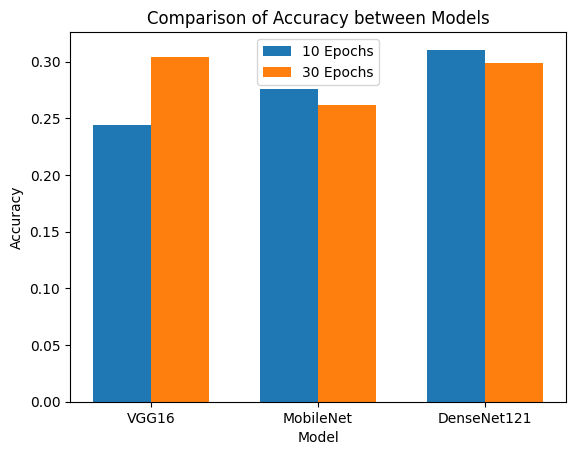

In [ ]:
models = ['VGG16', 'MobileNet', 'DenseNet121']
acc_10 = [0.24395, 0.27620, 0.31048]
acc_30 = [0.30443, 0.26209, 0.29838]
bar_width = 0.35

index = np.arange(len(models))

plt.bar(index, acc_10, width=bar_width, label='10 Epochs')
plt.bar(index + bar_width, acc_30, width=bar_width, label='30 Epochs')

plt.xlabel('Model')
plt.ylabel('Accuracy')
plt.title('Comparison of Accuracy between Models')
plt.xticks(index + bar_width/2, models)
plt.legend()

plt.show()